In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
from sklearn.decomposition import PCA
import itertools


In [2]:
df = pd.read_csv("Diabetes_Prediction_Updated.csv")
df.head()

,Diabetes_011,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
0,0,0,1,0,40,1,0,0,0,0,...,0,1,0,5,18,15,1,0,9,4
1,0,0,0,0,25,1,0,0,1,0,...,0,0,1,3,0,0,0,0,7,6
2,0,1,1,1,28,0,0,0,0,1,...,0,1,1,5,30,30,1,0,9,4
3,0,1,0,1,27,0,0,0,1,1,...,0,1,0,2,0,0,0,0,11,3
4,0,1,1,1,24,0,0,0,1,1,...,0,1,0,2,3,0,0,0,11,5


In [3]:
df.describe()

,Diabetes_011,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
count,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,...,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000,245494.000000
mean,0.140798,0.423941,0.420165,0.961926,28.341854,0.444422,0.040482,0.093021,0.761082,0.636622,...,0.056694,0.951164,0.082670,2.495177,3.147633,4.183662,0.165283,0.441388,8.021589,5.061109
std,0.347813,0.494182,0.493586,0.191376,6.605673,0.496903,0.197086,0.290462,0.426424,0.480973,...,0.231257,0.215526,0.275383,1.064800,7.351933,8.658251,0.371437,0.496554,3.053790,0.977444
min,0.000000,0.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,1.000000,24.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,6.000000,4.000000
50%,0.000000,0.000000,0.000000,1.000000,27.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,8.000000,5.000000
75%,0.000000,1.000000,1.000000,1.000000,31.000000,1.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,1.000000,0.000000,3.000000,2.000000,3.000000,0.000000,1.000000,10.000000,6.000000
max,1.000000,1.000000,1.000000,1.000000,98.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,5.000000,30.000000,30.000000,1.000000,1.000000,13.000000,6.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 245494 entries, 0 to 245493
Data columns (total 21 columns):
 #   Column                Non-Null Count   Dtype
---  ------                --------------   -----
 0   Diabetes_011          245494 non-null  int64
 1   HighBP                245494 non-null  int64
 2   HighChol              245494 non-null  int64
 3   CholCheck             245494 non-null  int64
 4   BMI                   245494 non-null  int64
 5   Smoke                 245494 non-null  int64
 6   Stroke                245494 non-null  int64
 7   HeartDiseaseorAttack  245494 non-null  int64
 8   PhysicalActivity      245494 non-null  int64
 9   Fruits                245494 non-null  int64
 10  Veggies               245494 non-null  int64
 11  AlcoholConsump        245494 non-null  int64
 12  AnyHealthcare         245494 non-null  int64
 13  NoDocbcCost           245494 non-null  int64
 14  GenHlth               245494 non-null  int64
 15  MentHlth              245494 non-n

In [5]:
df.shape

(245494, 21)

# Variable Analysis

In [7]:
diabetes_column = df['Diabetes_011']
df_scaled = df.drop(columns=['Diabetes_011'])

scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(df_scaled)

df_scaled = pd.DataFrame(scaled_data, columns=df_scaled.columns)

df_scaled['Diabetes_011'] = diabetes_column
df_scaled = df_scaled[['Diabetes_011', 'HighBP', 'HighChol', 'CholCheck', 'BMI', 'Smoke', 'Stroke',
       'HeartDiseaseorAttack', 'PhysicalActivity', 'Fruits', 'Veggies',
       'AlcoholConsump', 'AnyHealthcare', 'NoDocbcCost', 'GenHlth', 'MentHlth',
       'PhysHlth', 'DiffWalk', 'Sex', 'Age', 'Education']]
df_scaled.head()

,Diabetes_011,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
0,0,0.0,1.0,0.0,0.325581,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.00,0.6,0.5,1.0,0.0,0.666667,0.6
1,0,0.0,0.0,0.0,0.151163,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.50,0.0,0.0,0.0,0.0,0.500000,1.0
2,0,1.0,1.0,1.0,0.186047,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,1.0,1.00,1.0,1.0,1.0,0.0,0.666667,0.6
3,0,1.0,0.0,1.0,0.174419,0.0,0.0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.25,0.0,0.0,0.0,0.0,0.833333,0.4
4,0,1.0,1.0,1.0,0.139535,0.0,0.0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.25,0.1,0.0,0.0,0.0,0.833333,0.8


In [23]:
def scatter_plot_with_diabetes(df):
    num_cols = df.shape[1]
    num_rows = 4
    num_cols_per_row = 5
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols_per_row, figsize=(20, 16))

    for i in range(1, num_cols):  # Start from index 1 to exclude 'Diabetes_012'
        row_index = (i - 1) // num_cols_per_row
        col_index = (i - 1) % num_cols_per_row
        axes[row_index, col_index].scatter(df.iloc[:, i], df['Diabetes_012'], alpha=0.5)
        axes[row_index, col_index].set_xlabel(df.columns[i])
        axes[row_index, col_index].set_ylabel('Diabetes_012')

    plt.tight_layout()
    plt.show()

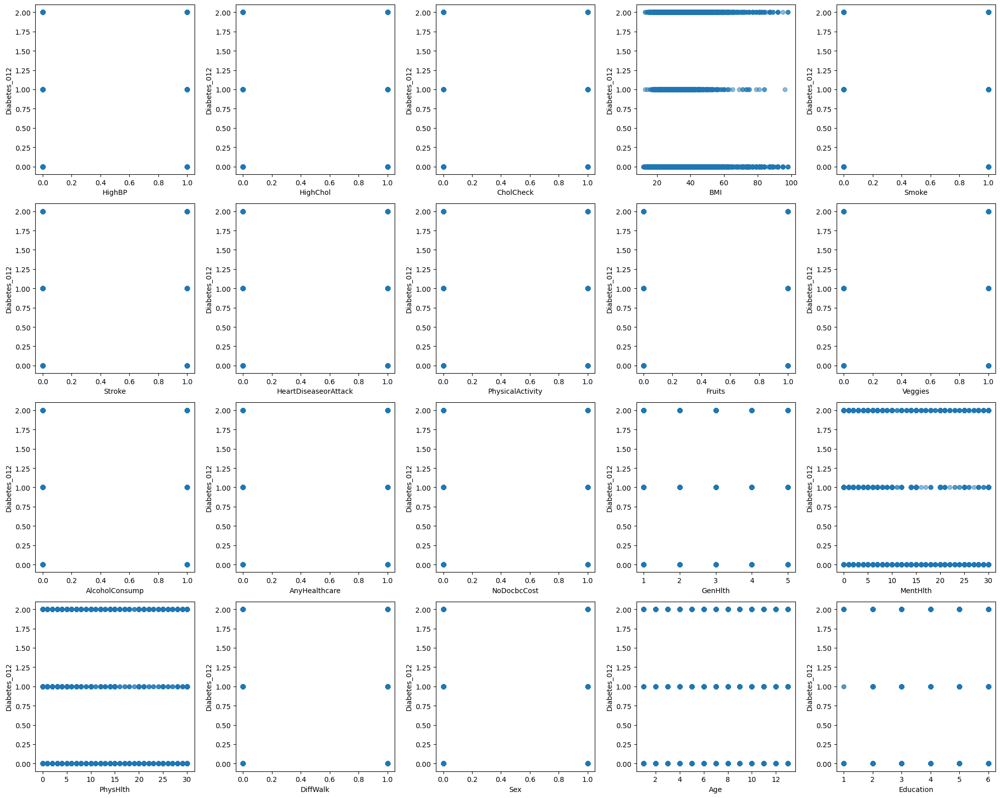

In [24]:
scatter_plot_with_diabetes(df)

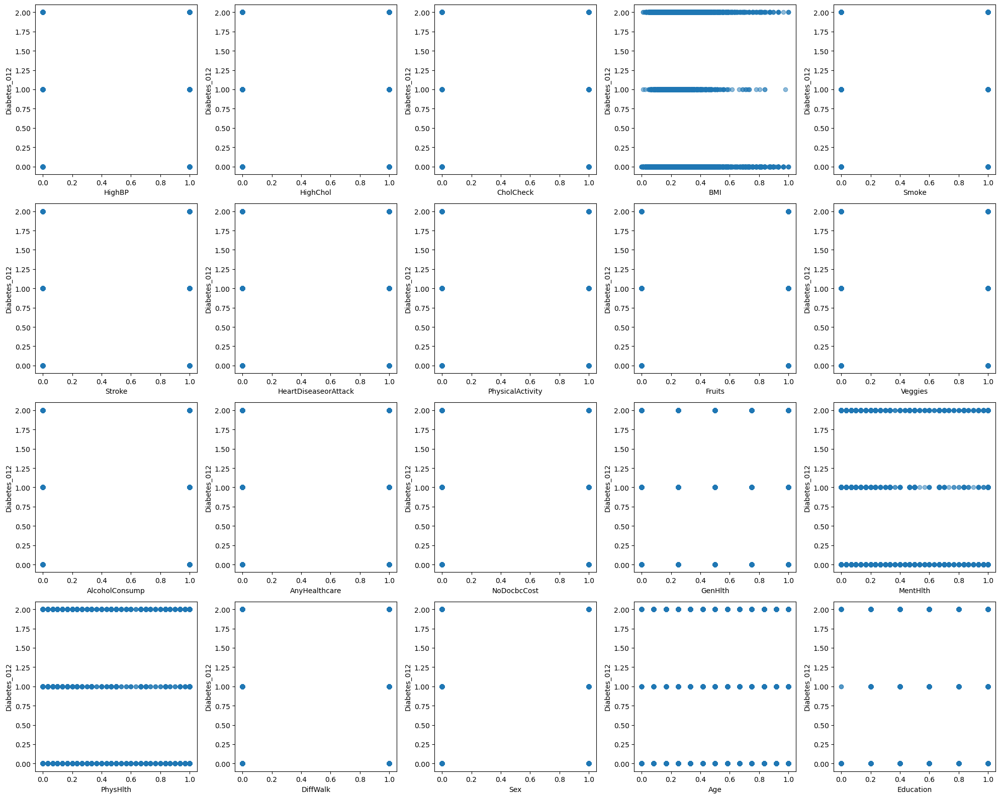

In [25]:
scatter_plot_with_diabetes(df_scaled)

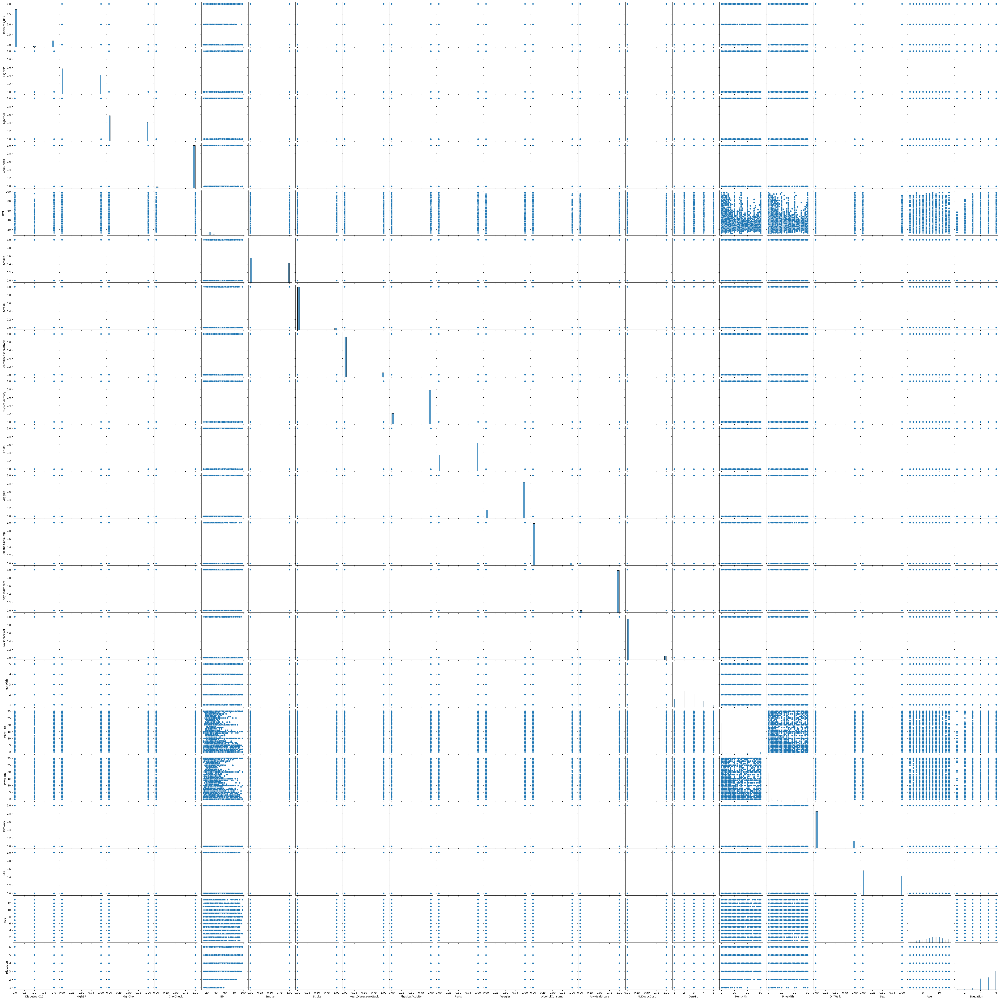

In [27]:
sns.pairplot(df)

In [8]:
df_corr = df.corr()
df_corr

,Diabetes_011,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
Diabetes_011,1.000000,0.269017,0.205836,0.065789,0.223202,0.063367,0.108255,0.180746,-0.119630,-0.041245,...,-0.057765,0.015542,0.033109,0.299038,0.072123,0.175489,0.222951,0.032842,0.180609,-0.125740
HighBP,0.269017,1.000000,0.298213,0.098313,0.213646,0.098531,0.131194,0.209768,-0.124980,-0.039853,...,-0.003365,0.037963,0.016466,0.298959,0.055203,0.160904,0.223207,0.054109,0.344944,-0.140063
HighChol,0.205836,0.298213,1.000000,0.085914,0.107266,0.091707,0.092934,0.182070,-0.077879,-0.040585,...,-0.010986,0.042938,0.011710,0.206896,0.060182,0.120725,0.143428,0.032471,0.272732,-0.068789
CholCheck,0.065789,0.098313,0.085914,1.000000,0.034263,-0.009509,0.024881,0.044661,0.005782,0.024539,...,-0.023754,0.118167,-0.059460,0.045625,-0.008625,0.031702,0.040394,-0.021876,0.090205,0.003075
BMI,0.223202,0.213646,0.107266,0.034263,1.000000,0.013298,0.021059,0.053541,-0.147644,-0.088076,...,-0.049120,-0.018158,0.057876,0.240964,0.085284,0.120828,0.196868,0.044535,-0.035811,-0.105082
Smoke,0.063367,0.098531,0.091707,-0.009509,0.013298,1.000000,0.060617,0.115493,-0.092147,-0.079500,...,0.101259,-0.023347,0.050173,0.167277,0.092823,0.118281,0.124434,0.091003,0.121217,-0.166799
Stroke,0.108255,0.131194,0.092934,0.024881,0.021059,0.060617,1.000000,0.203904,-0.071280,-0.013826,...,-0.016929,0.008759,0.034781,0.180147,0.070700,0.150335,0.179420,0.002976,0.127899,-0.077631
HeartDiseaseorAttack,0.180746,0.209768,0.182070,0.044661,0.053541,0.115493,0.203904,1.000000,-0.087877,-0.019999,...,-0.029452,0.018754,0.029442,0.259369,0.062639,0.181693,0.212703,0.086831,0.222549,-0.099163
PhysicalActivity,-0.119630,-0.124980,-0.077879,0.005782,-0.147644,-0.092147,-0.071280,-0.087877,1.000000,0.141783,...,0.011866,0.036149,-0.061057,-0.265031,-0.125330,-0.219341,-0.253544,0.030448,-0.093958,0.199293
Fruits,-0.041245,-0.039853,-0.040585,0.024539,-0.088076,-0.079500,-0.013826,-0.019999,0.141783,1.000000,...,-0.036275,0.031651,-0.043586,-0.103086,-0.067906,-0.044507,-0.048238,-0.092735,0.064432,0.109342


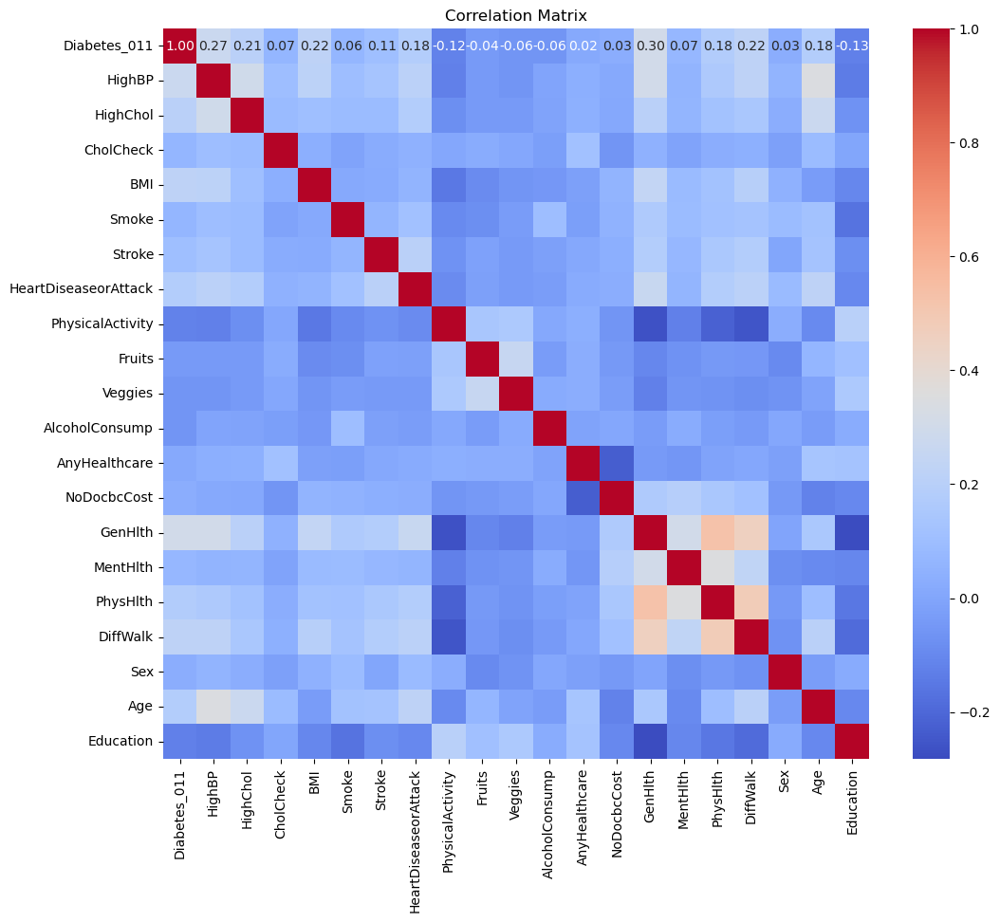

In [9]:
plt.figure(figsize=(12, 10))
sns.heatmap(df_corr, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix')
plt.show()

# PCA Without Scaling

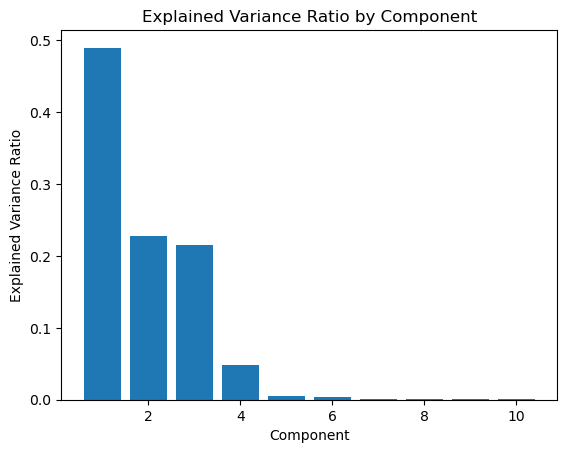

In [10]:
X = df.drop(columns=['Diabetes_011'])  # Features
y = df['Diabetes_011']  # Target

pca = PCA(n_components=10, random_state=1)
X_pca = pca.fit_transform(X)

explained_variance_ratio = pca.explained_variance_ratio_

plt.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio)
plt.xlabel('Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Component')
plt.show()

In [11]:
explained_variance_ratio

array([0.48937389, 0.22742362, 0.21561242, 0.0486489 , 0.00567761,
       0.00349431, 0.00155948, 0.00126407, 0.00123185, 0.00114854])

In [12]:
pca.components_

array([[ 8.97536893e-03,  6.79284666e-03,  5.05416735e-04,
         1.69709665e-01,  6.81346181e-03,  3.02955050e-03,
         5.23605024e-03, -1.05825501e-02, -3.65000868e-03,
        -3.26978067e-03, -3.71266349e-04, -6.71640981e-04,
         5.64385672e-03,  6.20156463e-02,  5.25875205e-01,
         8.30407352e-01,  1.88495838e-02, -3.09886511e-03,
         1.28512746e-02, -1.79750598e-02],
       [ 1.36566904e-02,  5.95407934e-03,  8.96339950e-04,
         9.82360309e-01, -1.49652692e-03, -3.89515067e-04,
         7.11414572e-04, -6.26024047e-03, -5.30428326e-03,
        -2.60530267e-03, -1.75709648e-03, -3.21194651e-04,
         2.77973107e-04,  1.90876636e-02, -1.48018522e-01,
        -1.08757502e-01,  5.05455941e-03,  4.93976261e-03,
        -2.02940921e-02, -1.00682008e-02],
       [-5.41798181e-03, -2.97125173e-03, -1.03214640e-03,
         6.43563695e-02, -2.38202988e-04, -1.49091378e-03,
        -3.74996944e-03,  2.41804216e-03, -3.18919566e-03,
        -7.94191529e-04,  1.5

In [13]:
X_pca.shape

(245494, 10)

In [14]:
df_pca = pd.DataFrame(X_pca, columns=["PC" + str(i+1) for i in range(X_pca.shape[1])])
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
0,18.987156,8.122027,7.166705,-1.735441,1.199784,-0.606896,-0.157833,-0.548405,0.062843,-0.657979
1,-5.692677,-2.349469,-0.471184,1.085927,0.053947,-1.123795,0.205251,-1.024155,0.129429,-0.726925
2,35.725183,-7.060252,8.323161,-1.327214,0.683580,-0.195755,-0.504390,0.193814,-0.761111,0.285406
3,-5.320511,-0.447267,-0.767881,-3.039697,1.394874,1.447966,-0.830104,0.228057,-0.122057,0.353585
4,-4.281172,-3.852586,1.541516,-3.179067,-0.162075,0.213552,-0.402064,0.687724,-0.632357,0.037473
...,...,...,...,...,...,...,...,...,...,...
245489,-3.193116,-7.535774,-2.349457,7.287975,2.408917,-0.997827,-1.057863,0.165684,0.011014,0.090043
245490,-5.643775,-2.370083,-0.698018,-1.019922,1.273721,-0.017865,-0.800014,0.373902,-0.277537,0.114792
245491,-6.142328,-5.276494,-0.790340,-0.017618,2.356640,0.445649,-0.692331,0.066540,-0.372519,0.380068
245492,-3.883491,8.538275,0.540416,3.695747,1.048796,0.770767,0.636102,0.193074,0.300750,-0.061487


In [15]:
df_pca[['Diabetes_011']] = df[['Diabetes_011']]

In [16]:
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,Diabetes_011
0,18.987156,8.122027,7.166705,-1.735441,1.199784,-0.606896,-0.157833,-0.548405,0.062843,-0.657979,0
1,-5.692677,-2.349469,-0.471184,1.085927,0.053947,-1.123795,0.205251,-1.024155,0.129429,-0.726925,0
2,35.725183,-7.060252,8.323161,-1.327214,0.683580,-0.195755,-0.504390,0.193814,-0.761111,0.285406,0
3,-5.320511,-0.447267,-0.767881,-3.039697,1.394874,1.447966,-0.830104,0.228057,-0.122057,0.353585,0
4,-4.281172,-3.852586,1.541516,-3.179067,-0.162075,0.213552,-0.402064,0.687724,-0.632357,0.037473,0
...,...,...,...,...,...,...,...,...,...,...,...
245489,-3.193116,-7.535774,-2.349457,7.287975,2.408917,-0.997827,-1.057863,0.165684,0.011014,0.090043,0
245490,-5.643775,-2.370083,-0.698018,-1.019922,1.273721,-0.017865,-0.800014,0.373902,-0.277537,0.114792,0
245491,-6.142328,-5.276494,-0.790340,-0.017618,2.356640,0.445649,-0.692331,0.066540,-0.372519,0.380068,1
245492,-3.883491,8.538275,0.540416,3.695747,1.048796,0.770767,0.636102,0.193074,0.300750,-0.061487,1


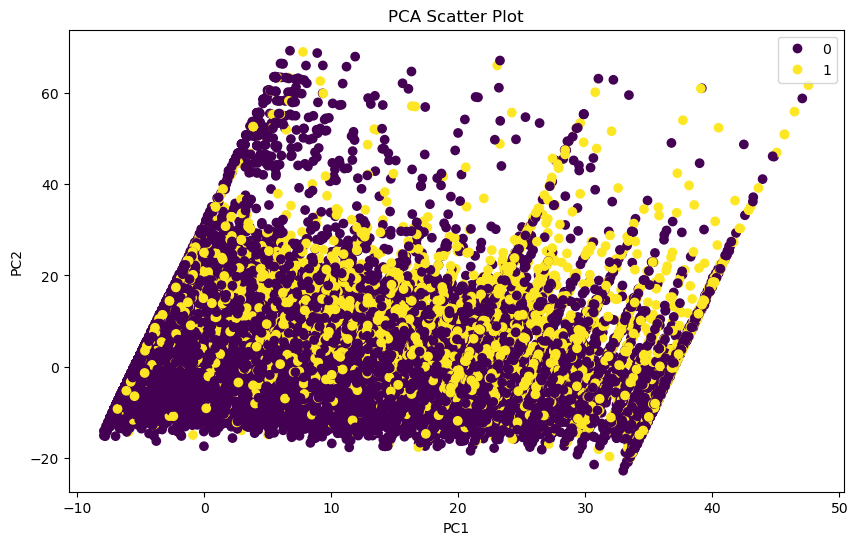

In [17]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['Diabetes_011'], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
#plt.colorbar(scatter, label='Diabetes_012')
plt.show()

In [18]:
# Get the absolute loadings for each variable on each principal component
loadings = pd.DataFrame(pca.components_.T, columns=[f"PC{i + 1}" for i in range(X_pca.shape[1])], index=X.columns)

# Identify the top 3 contributing variables for each principal component
top_contributing_vars = {}
for pc in df_pca.columns:
    if pc != "Diabetes_011":
        sorted_vars = loadings[pc].abs().sort_values(ascending=False)
        top_contributing_vars[pc] = sorted_vars.index[:3].tolist()

# Print the top contributing variables for each principal component
for pc, vars_list in top_contributing_vars.items():
    print(f"Principal Component {pc}:")
    for rank, var in enumerate(vars_list, start=1):
        print(f"  {rank}. {var}")
    print()


Principal Component PC1:
  1. PhysHlth
  2. MentHlth
  3. BMI

Principal Component PC2:
  1. BMI
  2. MentHlth
  3. PhysHlth

Principal Component PC3:
  1. MentHlth
  2. PhysHlth
  3. Age

Principal Component PC4:
  1. Age
  2. MentHlth
  3. PhysHlth

Principal Component PC5:
  1. Education
  2. GenHlth
  3. Smoke

Principal Component PC6:
  1. GenHlth
  2. Education
  3. HighBP

Principal Component PC7:
  1. Sex
  2. Fruits
  3. Smoke

Principal Component PC8:
  1. Fruits
  2. HighChol
  3. HighBP

Principal Component PC9:
  1. Smoke
  2. HighChol
  3. Fruits

Principal Component PC10:
  1. Smoke
  2. Sex
  3. HighChol



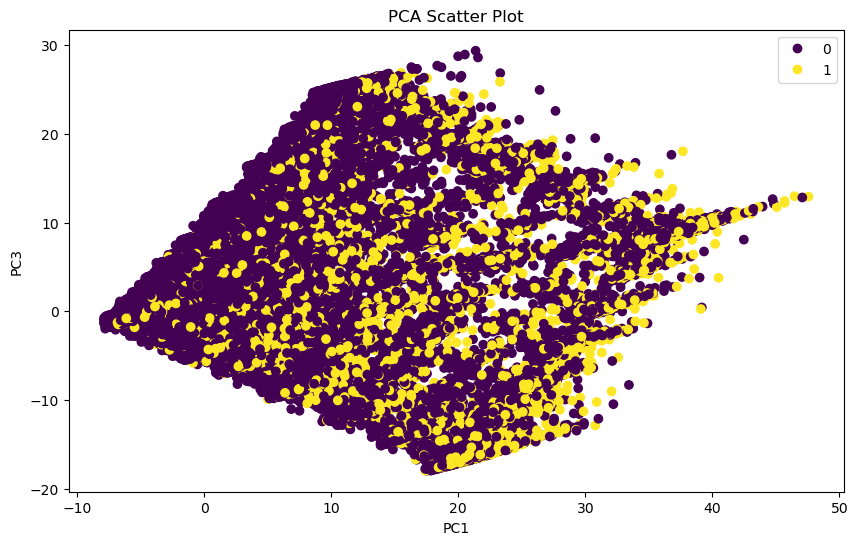

In [19]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC1'], df_pca['PC3'], c=df_pca['Diabetes_011'], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC3')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
#plt.colorbar(scatter, label='Diabetes_012')
plt.show()

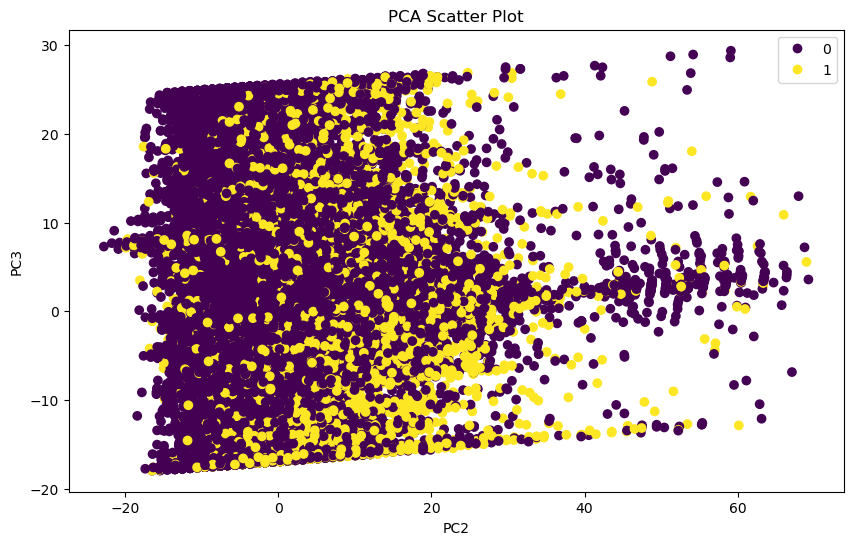

In [20]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC2'], df_pca['PC3'], c=df_pca['Diabetes_011'], cmap='viridis')
plt.xlabel('PC2')
plt.ylabel('PC3')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
#plt.colorbar(scatter, label='Diabetes_012')
plt.show()

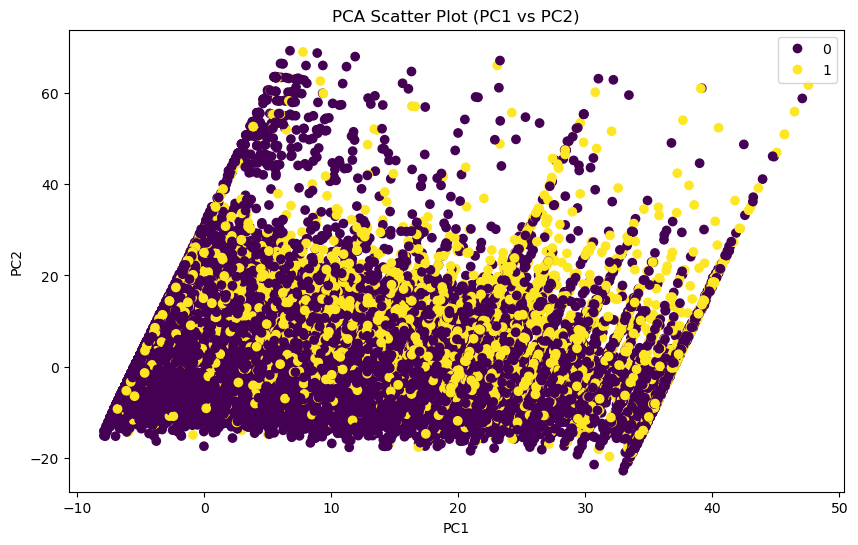

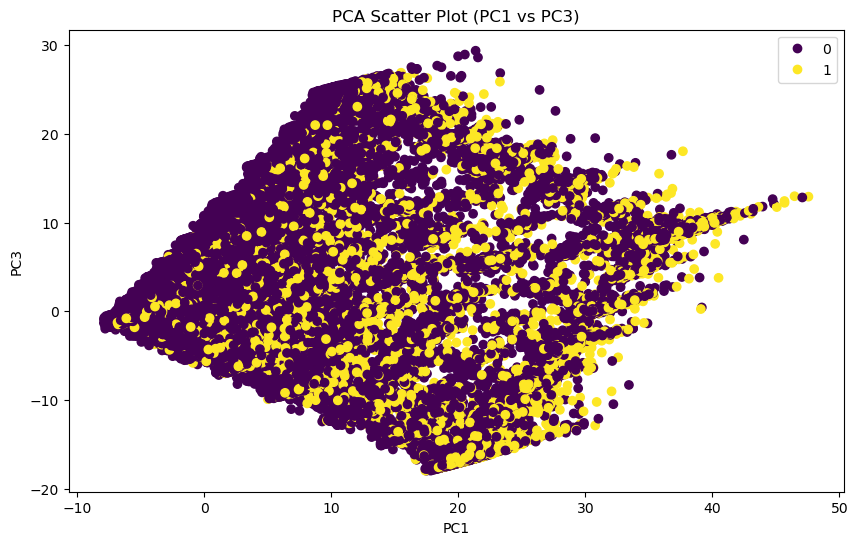

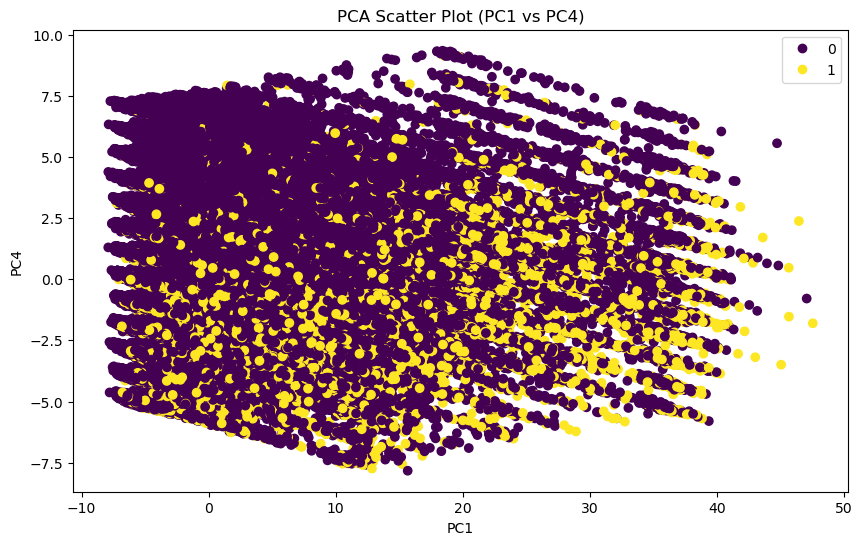

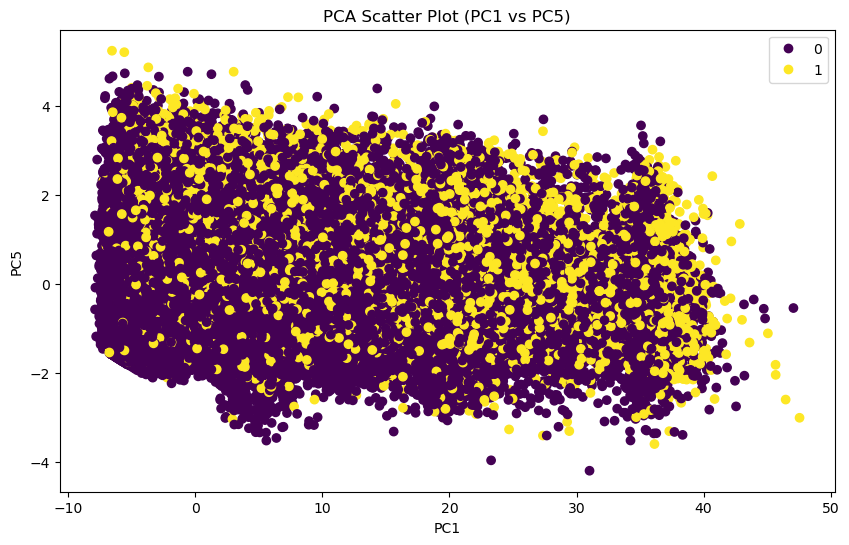

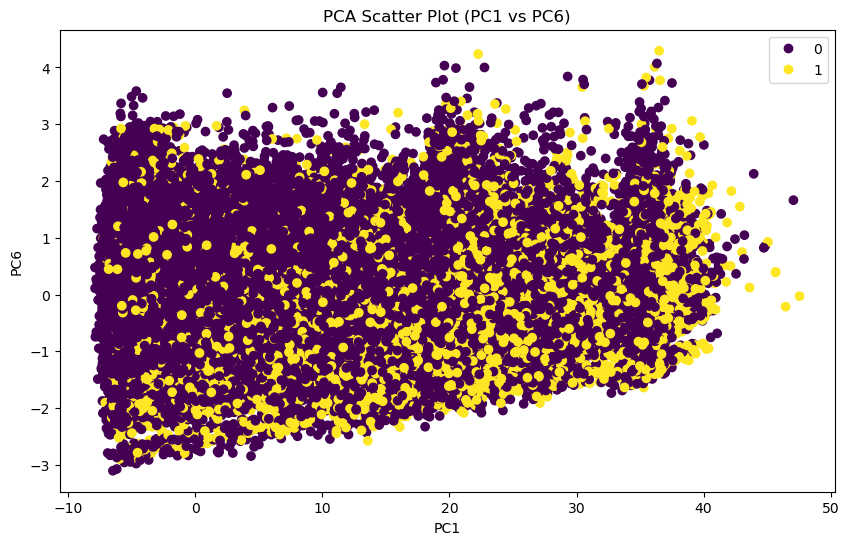

...

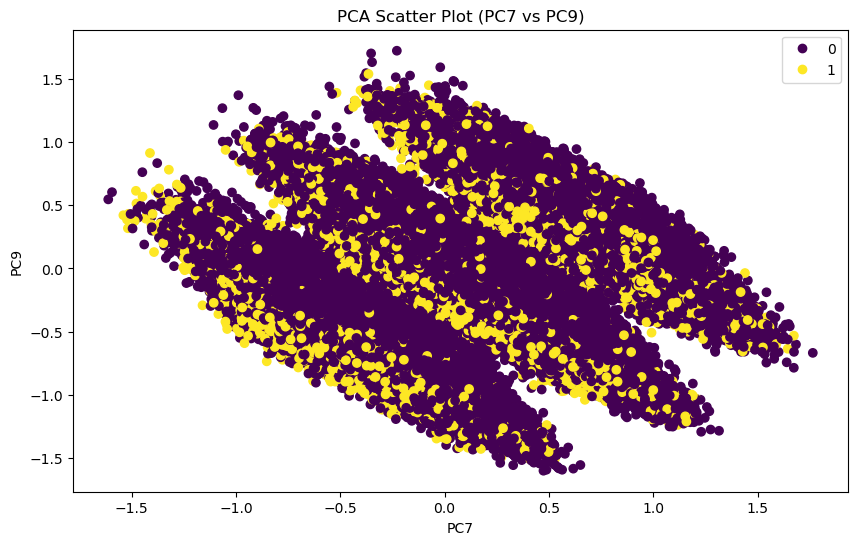

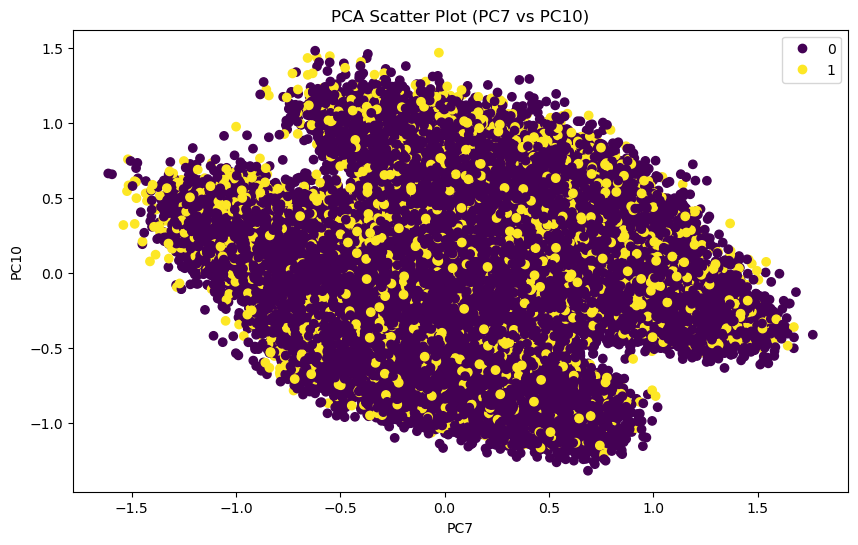

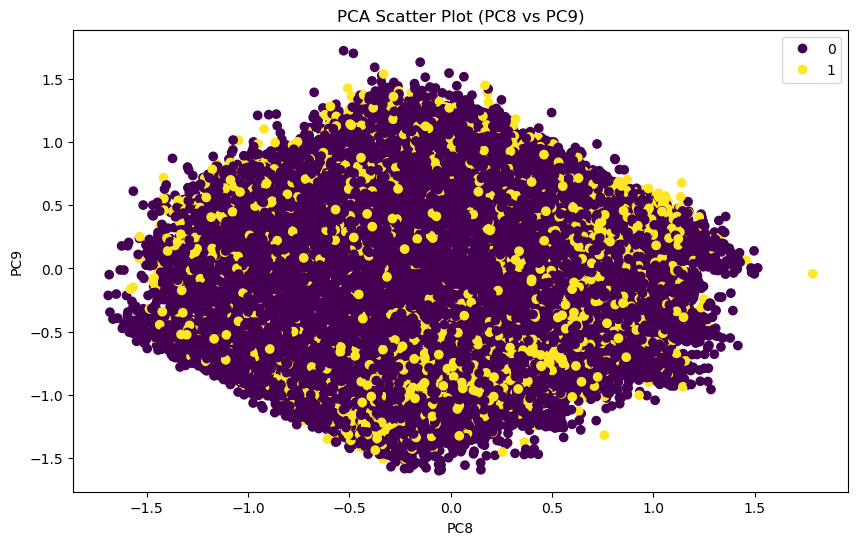

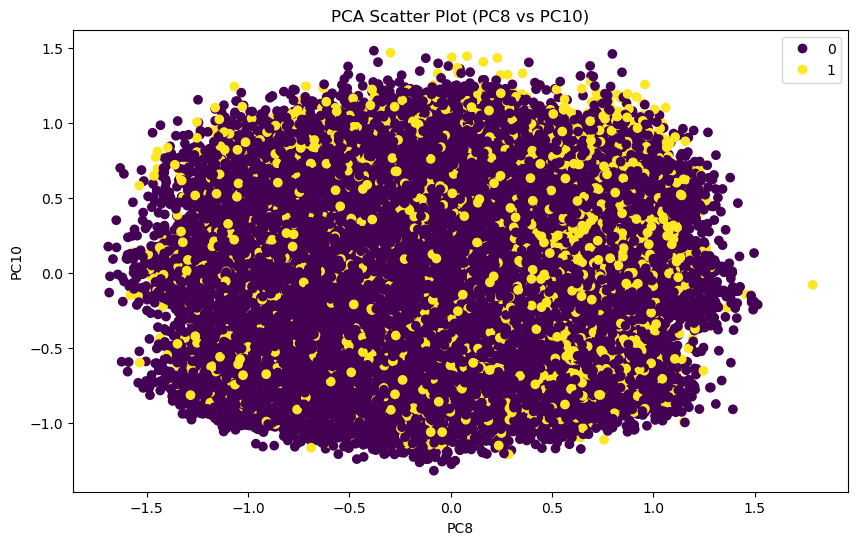

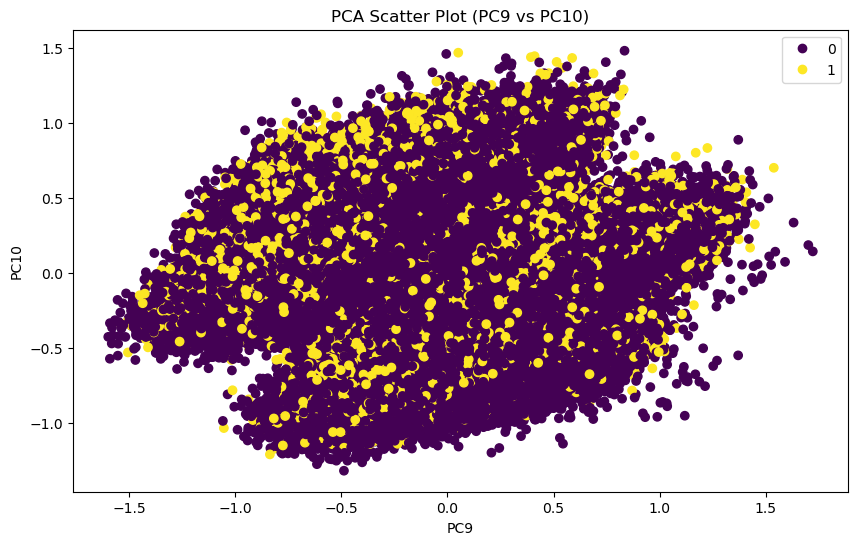

In [21]:
# Define the combinations of PC interactions
pc_combinations = list(itertools.combinations(df_pca.drop(columns=["Diabetes_011"]).columns, 2))

# Plot scatter plot for each combination of PC interactions
for pc1, pc2 in pc_combinations:
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(df_pca[pc1], df_pca[pc2], c=df_pca['Diabetes_011'], cmap='viridis')
    plt.xlabel(pc1)
    plt.ylabel(pc2)
    plt.title(f'PCA Scatter Plot ({pc1} vs {pc2})')
    plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
    plt.show()

# PCA With Scaling

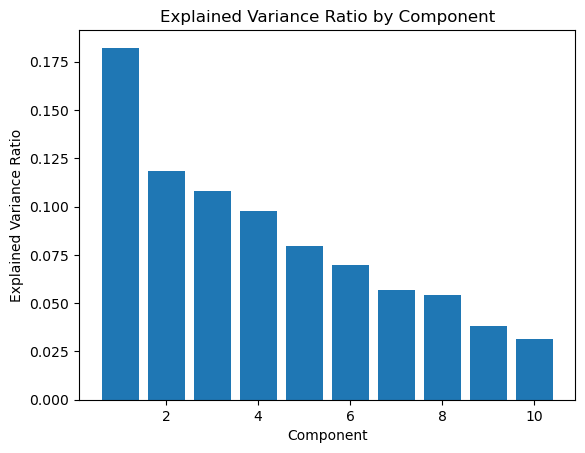

In [22]:
X = df_scaled.drop(columns=['Diabetes_011'])  # Features
y = df_scaled['Diabetes_011']  # Target

pca = PCA(n_components=10, random_state=1)
X_pca = pca.fit_transform(X)

explained_variance_ratio = pca.explained_variance_ratio_

plt.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio)
plt.xlabel('Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Component')
plt.show()

In [23]:
explained_variance_ratio

array([0.18219564, 0.11860415, 0.10780262, 0.09756286, 0.07977008,
       0.06993841, 0.05701348, 0.05401573, 0.03793042, 0.03139724])

In [24]:
pca.components_

array([[ 5.18298387e-01,  4.54662123e-01,  2.58299922e-02,
         2.97876131e-02,  3.29119411e-01,  6.87051963e-02,
         1.68188739e-01, -2.78674152e-01, -2.10520432e-01,
        -1.49072035e-01,  2.17949432e-03,  2.04649319e-03,
         4.79586530e-02,  2.36182368e-01,  8.92897054e-02,
         1.96715087e-01,  3.00330018e-01,  9.83768971e-02,
         1.56375317e-01, -9.20687981e-02],
       [-2.46516856e-01, -2.59860501e-01, -3.59454495e-02,
        -1.04362674e-03,  2.86923514e-01, -2.20151908e-02,
        -2.70285455e-02, -5.41775940e-02, -5.72564342e-01,
        -2.47295328e-01,  2.96758722e-02, -3.43034386e-02,
         3.67133383e-03, -3.81106456e-02, -1.55430015e-02,
        -5.83901827e-02, -1.15749002e-01,  6.00096059e-01,
        -1.17724441e-01, -2.00481319e-02],
       [-2.37498695e-01, -3.11614964e-01, -1.97589745e-02,
         6.82868975e-03, -2.58542048e-02,  1.00857151e-02,
        -4.83023945e-02, -3.76146385e-01, -3.64990409e-01,
        -2.01029786e-01, -1.2

In [25]:
df_pca = pd.DataFrame(X_pca, columns=["PC" + str(i+1) for i in range(X_pca.shape[1])])
df_pca[['Diabetes_011']] = df[['Diabetes_011']]
df_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,Diabetes_011
0,1.004303,0.087383,1.059786,-0.369679,-0.298682,0.780735,0.322551,-0.464816,-0.082485,-0.323652,0
1,-0.172487,0.763445,0.884301,-0.298245,-0.488276,-0.275800,0.124260,0.666049,0.867325,0.402336,0
2,1.335739,-0.838867,0.884007,0.423915,0.708867,0.625272,0.235105,0.686970,0.879219,-0.181439,0
3,-0.313969,-0.681485,-0.052305,0.182571,0.281167,-0.715547,-0.136092,0.002018,-0.041781,0.011439,0
4,0.111755,-0.950882,-0.379169,0.407945,-0.306199,-0.233913,-0.152325,-0.012437,0.048352,-0.075779,0


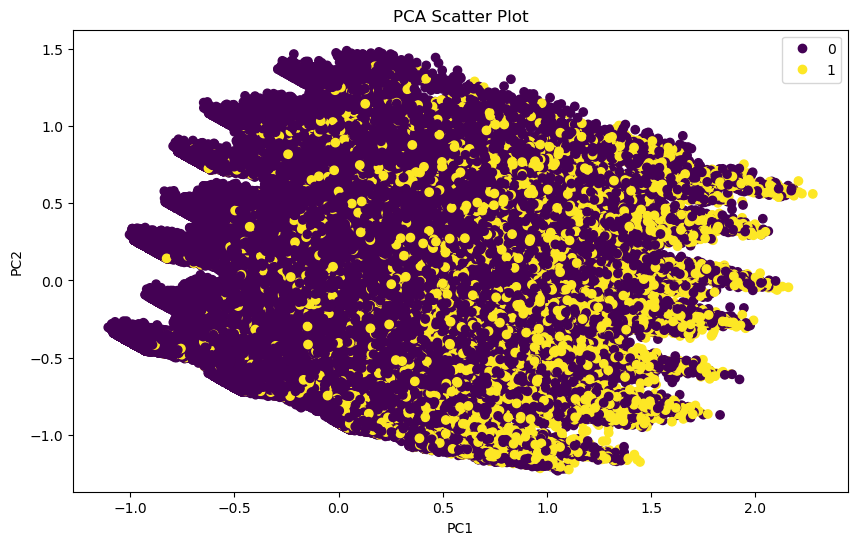

In [26]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['Diabetes_011'], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])
plt.show()

In [27]:
# Get the absolute loadings for each variable on each principal component
loadings = pd.DataFrame(pca.components_.T, columns=[f"PC{i + 1}" for i in range(X_pca.shape[1])], index=X.columns)

# Identify the top 3 contributing variables for each principal component
top_contributing_vars = {}
for pc in df_pca.columns:
    if pc != "Diabetes_011":
        sorted_vars = loadings[pc].abs().sort_values(ascending=False)
        top_contributing_vars[pc] = sorted_vars.index[:3].tolist()

# Print the top contributing variables for each principal component
for pc, vars_list in top_contributing_vars.items():
    print(f"Principal Component {pc}:")
    for rank, var in enumerate(vars_list, start=1):
        print(f"  {rank}. {var}")
    print()


Principal Component PC1:
  1. HighBP
  2. HighChol
  3. Smoke

Principal Component PC2:
  1. Sex
  2. Fruits
  3. Smoke

Principal Component PC3:
  1. Sex
  2. PhysicalActivity
  3. Fruits

Principal Component PC4:
  1. Smoke
  2. Fruits
  3. HighChol

Principal Component PC5:
  1. HighChol
  2. Sex
  3. Fruits

Principal Component PC6:
  1. HighBP
  2. HighChol
  3. PhysicalActivity

Principal Component PC7:
  1. PhysicalActivity
  2. DiffWalk
  3. PhysHlth

Principal Component PC8:
  1. Veggies
  2. PhysicalActivity
  3. Fruits

Principal Component PC9:
  1. NoDocbcCost
  2. Age
  3. AnyHealthcare

Principal Component PC10:
  1. HeartDiseaseorAttack
  2. DiffWalk
  3. NoDocbcCost



In [28]:
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,Diabetes_011
0,1.004303,0.087383,1.059786,-0.369679,-0.298682,0.780735,0.322551,-0.464816,-0.082485,-0.323652,0
1,-0.172487,0.763445,0.884301,-0.298245,-0.488276,-0.275800,0.124260,0.666049,0.867325,0.402336,0
2,1.335739,-0.838867,0.884007,0.423915,0.708867,0.625272,0.235105,0.686970,0.879219,-0.181439,0
3,-0.313969,-0.681485,-0.052305,0.182571,0.281167,-0.715547,-0.136092,0.002018,-0.041781,0.011439,0
4,0.111755,-0.950882,-0.379169,0.407945,-0.306199,-0.233913,-0.152325,-0.012437,0.048352,-0.075779,0
...,...,...,...,...,...,...,...,...,...,...,...
245489,-0.492857,-0.445404,0.655491,-0.134829,0.494523,0.304500,0.846011,0.151874,0.815307,0.077926,0
245490,-0.363729,-0.688721,-0.101066,0.212662,-0.489903,0.461810,0.029390,0.050426,-0.051020,0.009583,0
245491,-0.146677,-0.414225,0.193480,0.393525,0.320524,-0.674090,-0.319013,0.880268,0.059930,-0.004186,1
245492,0.434758,0.571561,-0.111397,-0.297373,0.731714,-0.226246,-1.030304,0.499111,0.205790,-0.126787,1


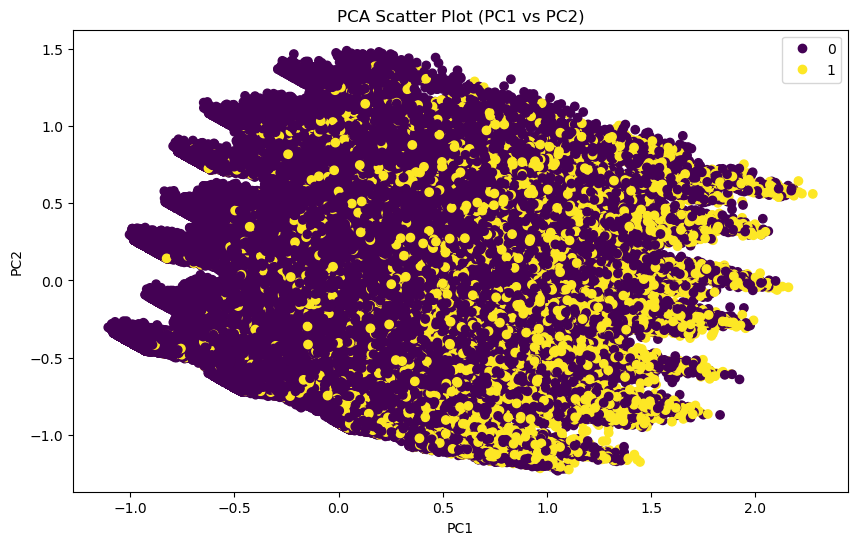

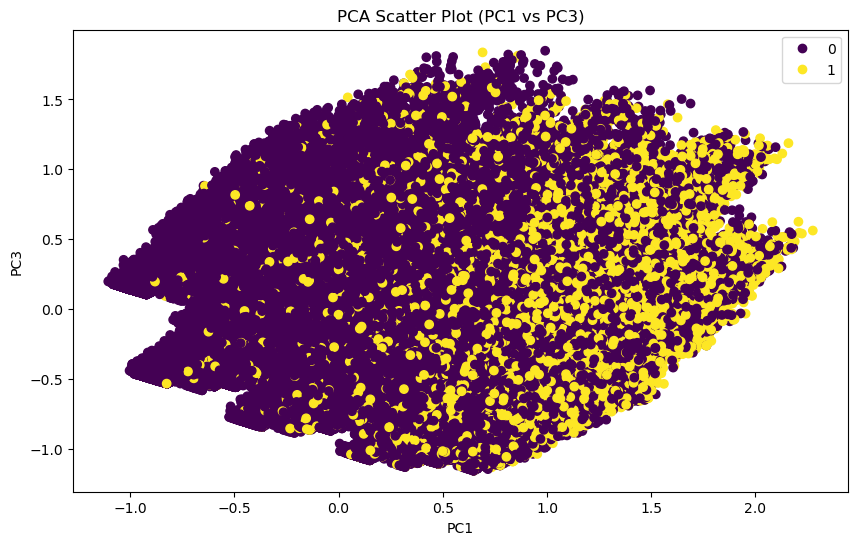

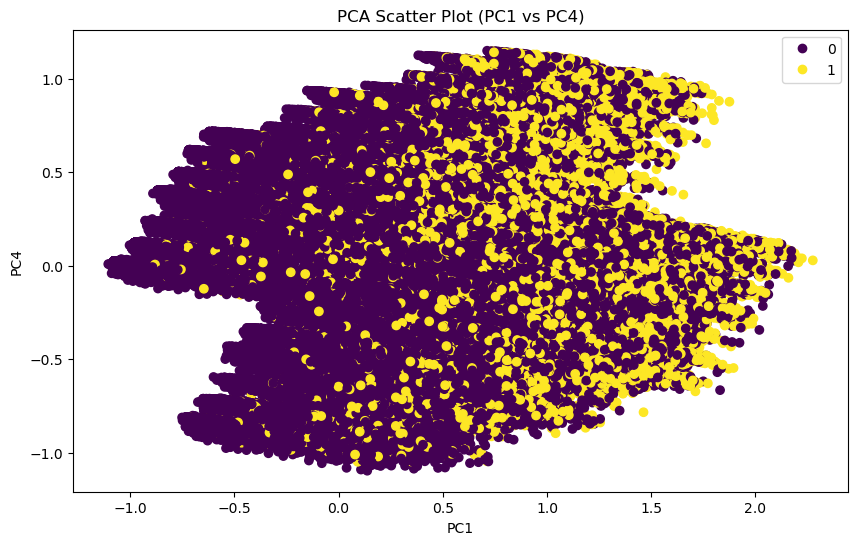

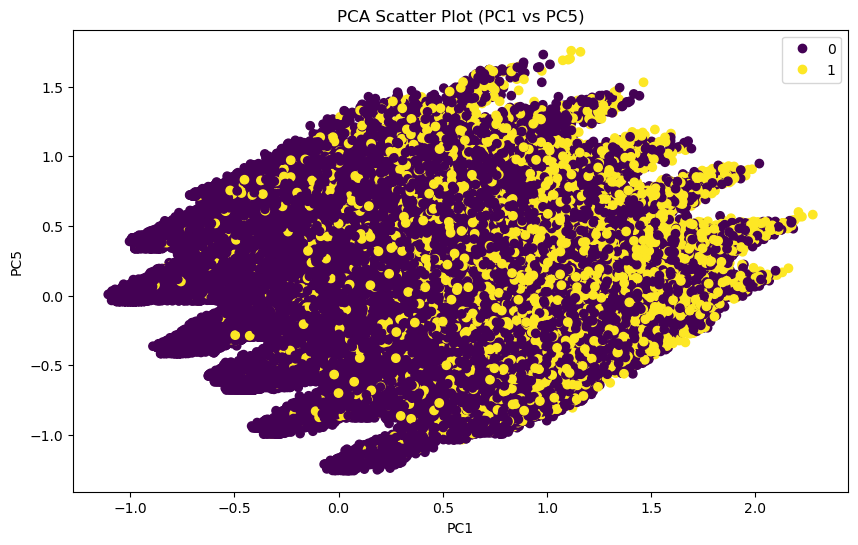

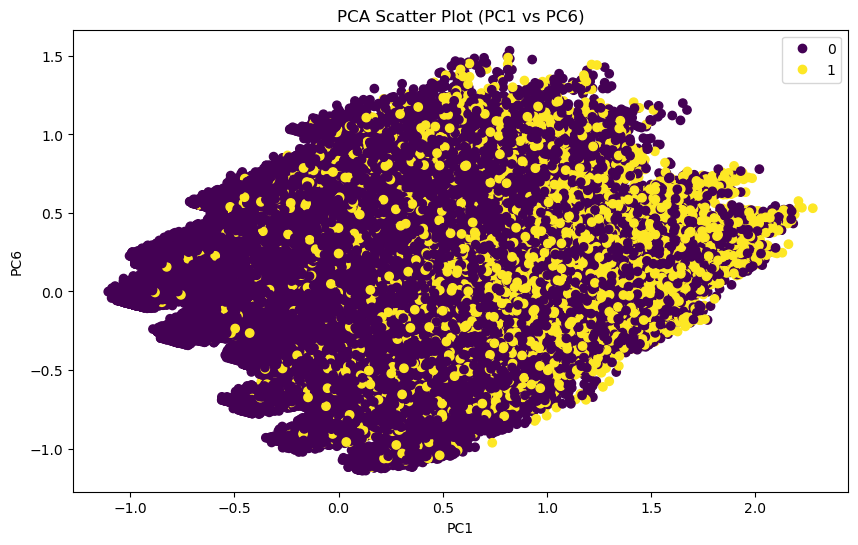

...

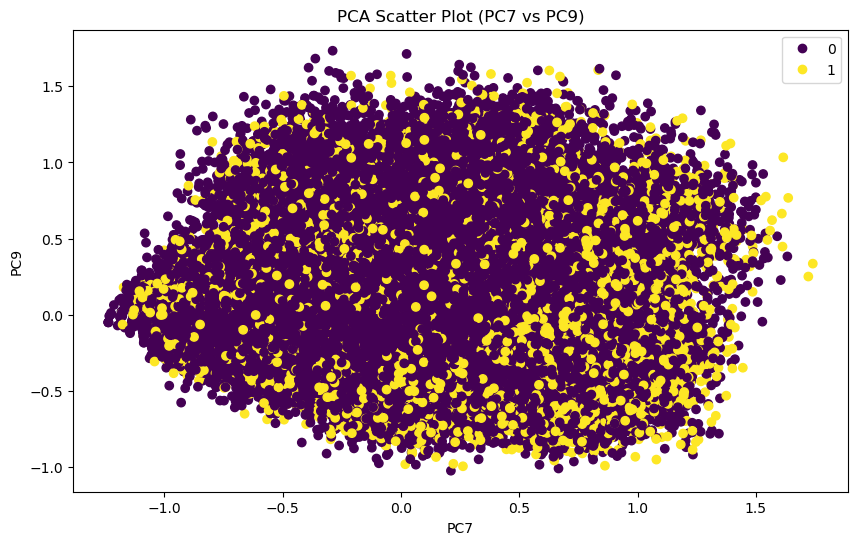

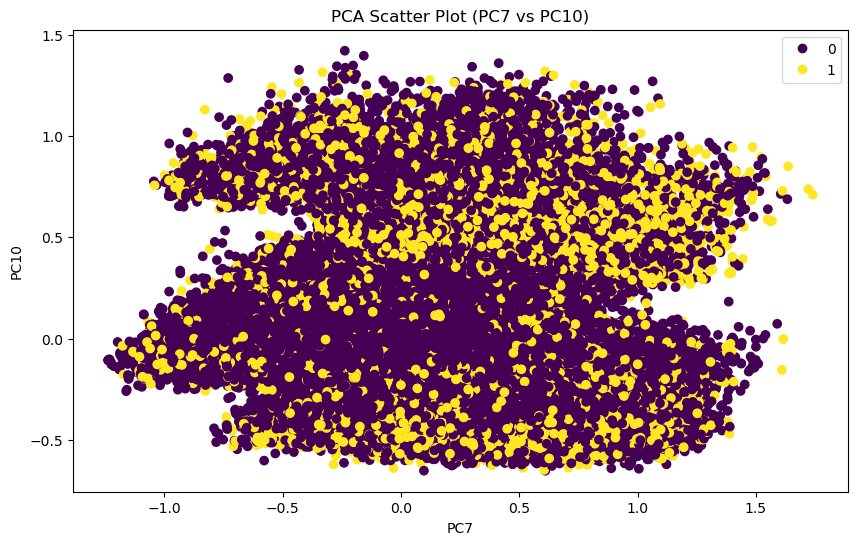

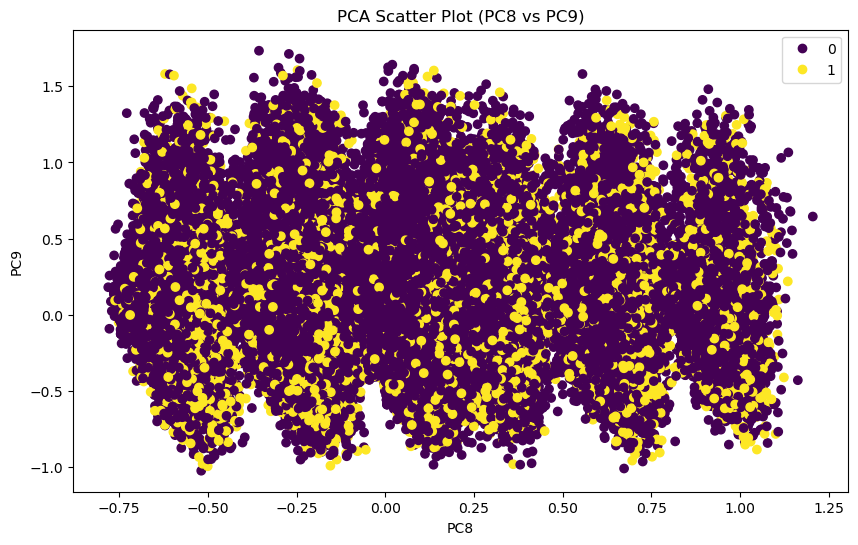

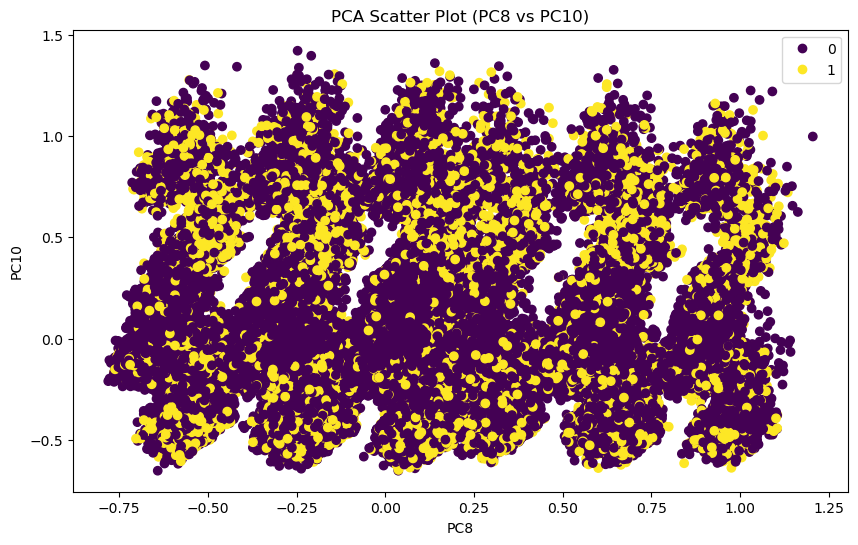

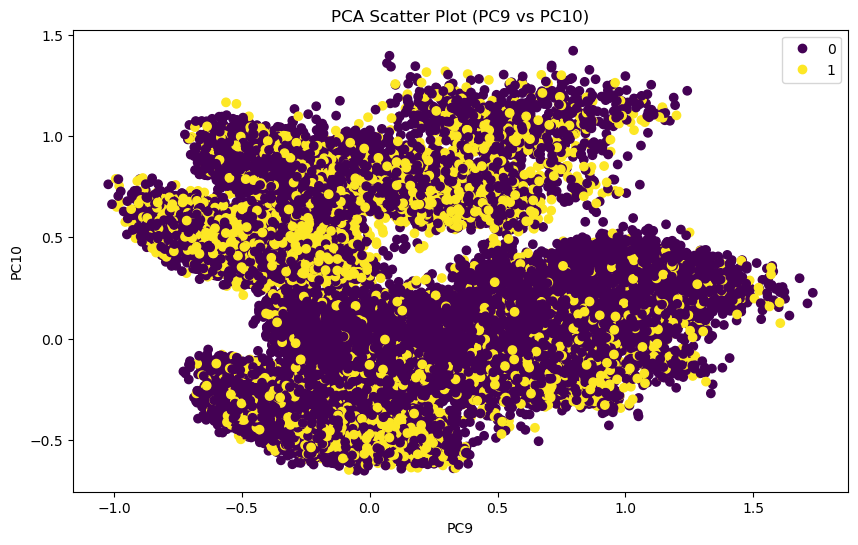

In [29]:
# Define the combinations of PC interactions
pc_combinations = list(itertools.combinations(df_pca.drop(columns=["Diabetes_011"]).columns, 2))

# Plot scatter plot for each combination of PC interactions
for pc1, pc2 in pc_combinations:
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(df_pca[pc1], df_pca[pc2], c=df_pca['Diabetes_011'], cmap='viridis')
    plt.xlabel(pc1)
    plt.ylabel(pc2)
    plt.title(f'PCA Scatter Plot ({pc1} vs {pc2})')
    plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
    plt.show()